In [28]:
import numpy as np 
import scipy as sp
import matplotlib.pyplot as plt

In [29]:
###### Define the lagrangian of the system ######

def lagrangian(x,y,vx,vy,m,N):
    KE=0
    PE=0
    G=1
    for i in range(N):
        KE+=0.5*m[i]*(vx[i]**2 + vy[i]**2)  #Kinetic Energy for each particle
        for j in range(i+1,N):      #Potential Energy between each pair of particles
            r_ij=np.linalg.norm(np.array([x[i],y[i]])-np.array([x[j],y[j]]))   #Distance between particle i and j
            PE+=-G*m[i]*m[j]/r_ij 
    L=KE-PE
    return L

###### Generate physical variables ######
N=5  #Number of particles
m=np.random.randint(1,10,size=N)  #Masses of the particles
x=np.random.randint(-50,50,size=N)  #x positions
y=np.random.randint(-50,50,size=N)  #y positions
vx=np.random.randint(-5,5,size=N)   #x velocities
vy=np.random.randint(-5,5,size=N)   #y velocities
L=lagrangian(x,y,vx,vy,m,N)
print("Lagrangian of the system:", L)





Lagrangian of the system: 114.65758013839705


In [72]:
import sympy as sp
import multiprocessing as mp

t = sp.Symbol('t', real=True)
G = sp.Symbol('G', positive=True)
N = 3
m = sp.symbols(f'm1:{N+1}', positive=True)

# 1) Create picklable Function *classes* and bind them in globals()
xF = [sp.Function(f'x_{i+1}') for i in range(N)]
yF = [sp.Function(f'y_{i+1}') for i in range(N)]
for f in xF + yF:
    globals()[f.__name__] = f   # creates globals: x_1, x_2, ..., y_1, ...

# 2) Now build time-dependent coordinates
x = [xF[i](t) for i in range(N)]
y = [yF[i](t) for i in range(N)]
xd = [sp.diff(xi, t) for xi in x]
yd = [sp.diff(yi, t) for yi in y]

T = sum(sp.Rational(1,2)*m[i]*(xd[i]**2 + yd[i]**2) for i in range(N))
V = sum(-G*m[i]*m[j] / sp.sqrt((x[i]-x[j])**2 + (y[i]-y[j])**2)
        for i in range(N) for j in range(i+1, N))
L = T - V

q = x + y
qd = [sp.diff(qi, t) for qi in q]
raw_eom = [sp.diff(sp.diff(L, qd[i]), t) - sp.diff(L, q[i]) for i in range(2*N)]

def _simp(expr):
    return sp.simplify(expr)

ctx = mp.get_context("fork")
with ctx.Pool(processes=min(ctx.cpu_count(), len(raw_eom))) as pool:
    eom = list(pool.map(_simp, raw_eom, chunksize=1))

In [94]:
# accelerations (unknowns we solve for)
xdd = [sp.diff(xi, t, 2) for xi in x]
ydd = [sp.diff(yi, t, 2) for yi in y]
acc = xdd + ydd

# solve eom == 0 for accelerations
sol_list = sp.solve(eom, acc, dict=True, simplify=False)
sol = sol_list[0]   # <- dict mapping each accel to its expression

# extract explicit expressions for each accel [unpacking from the dictionary]
xdd_expr = [sol[xdd[i]] for i in range(N)]
ydd_expr = [sol[ydd[i]] for i in range(N)]



In [ ]:
#simplify the expressions
xdd_expr = [sp.together(sp.simplify(expr)) for expr in xdd_expr]
ydd_expr = [sp.together(sp.simplify(expr)) for expr in ydd_expr]

xdd_expr[0], ydd_expr[0]

(G*(-m2*sqrt(x_1(t)**2 - 2*x_1(t)*x_3(t) + x_3(t)**2 + y_1(t)**2 - 2*y_1(t)*y_3(t) + y_3(t)**2)*x_1(t)**3 + m2*sqrt(x_1(t)**2 - 2*x_1(t)*x_3(t) + x_3(t)**2 + y_1(t)**2 - 2*y_1(t)*y_3(t) + y_3(t)**2)*x_1(t)**2*x_2(t) + 2*m2*sqrt(x_1(t)**2 - 2*x_1(t)*x_3(t) + x_3(t)**2 + y_1(t)**2 - 2*y_1(t)*y_3(t) + y_3(t)**2)*x_1(t)**2*x_3(t) - 2*m2*sqrt(x_1(t)**2 - 2*x_1(t)*x_3(t) + x_3(t)**2 + y_1(t)**2 - 2*y_1(t)*y_3(t) + y_3(t)**2)*x_1(t)*x_2(t)*x_3(t) - m2*sqrt(x_1(t)**2 - 2*x_1(t)*x_3(t) + x_3(t)**2 + y_1(t)**2 - 2*y_1(t)*y_3(t) + y_3(t)**2)*x_1(t)*x_3(t)**2 - m2*sqrt(x_1(t)**2 - 2*x_1(t)*x_3(t) + x_3(t)**2 + y_1(t)**2 - 2*y_1(t)*y_3(t) + y_3(t)**2)*x_1(t)*y_1(t)**2 + 2*m2*sqrt(x_1(t)**2 - 2*x_1(t)*x_3(t) + x_3(t)**2 + y_1(t)**2 - 2*y_1(t)*y_3(t) + y_3(t)**2)*x_1(t)*y_1(t)*y_3(t) - m2*sqrt(x_1(t)**2 - 2*x_1(t)*x_3(t) + x_3(t)**2 + y_1(t)**2 - 2*y_1(t)*y_3(t) + y_3(t)**2)*x_1(t)*y_3(t)**2 + m2*sqrt(x_1(t)**2 - 2*x_1(t)*x_3(t) + x_3(t)**2 + y_1(t)**2 - 2*y_1(t)*y_3(t) + y_3(t)**2)*x_2(t)*x_3(t)**2 

In [103]:
from scipy.integrate import solve_ivp

# Replace x_i(t), y_i(t) with plain symbols so lambdify is fast/clean
X = sp.symbols(f'X1:{N+1}', real=True)
Y = sp.symbols(f'Y1:{N+1}', real=True)

subs_xy = {x[i]: X[i] for i in range(N)}
subs_xy.update({y[i]: Y[i] for i in range(N)})

xdd_sym = [expr.subs(subs_xy) for expr in xdd_expr]
ydd_sym = [expr.subs(subs_xy) for expr in ydd_expr]
acc_sym = xdd_sym + ydd_sym  # length 2N

# args are: X1..XN, Y1..YN, m1..mN, G
acc_func = sp.lambdify([*X, *Y, *m, G], acc_sym, modules="numpy")

def rhs(t_num, state, m_vals, G_val=1.0):
    x_num  = state[0:N]
    y_num  = state[N:2*N]
    vx_num = state[2*N:3*N]
    vy_num = state[3*N:4*N]

    axay = np.asarray(acc_func(*x_num, *y_num, *m_vals, G_val), dtype=float).reshape(2*N)
    ax = axay[:N]
    ay = axay[N:]
    return np.concatenate([vx_num, vy_num, ax, ay])

# Example numeric parameters + initial conditions (edit these)
m_vals = np.array([500.0, 3.0, 4.0])
G_val = 1.0

x0  = np.array([0.0,  0.0,  0.0])
y0  = np.array([ 0.0,  05.0,  12.5])
vx0 = np.array([ 0.0,  np.sqrt(G_val * m_vals[0] / y0[1]),  np.sqrt(G_val * m_vals[0] / y0[2])])
vy0 = np.array([ 0.0,  0.0, -0.1])

y_init = np.concatenate([x0, y0, vx0, vy0])

t_span = (0.0, 50.0)
t_eval = np.linspace(t_span[0], t_span[1], 2000)

sol_num = solve_ivp(
    fun=lambda tt, yy: rhs(tt, yy, m_vals, G_val),
    t_span=t_span,
    y0=y_init,
    t_eval=t_eval,
    rtol=1e-9,
    atol=1e-9,
)

sol_num.success, sol_num.message

(True, 'The solver successfully reached the end of the integration interval.')

Animation size has reached 20986081 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


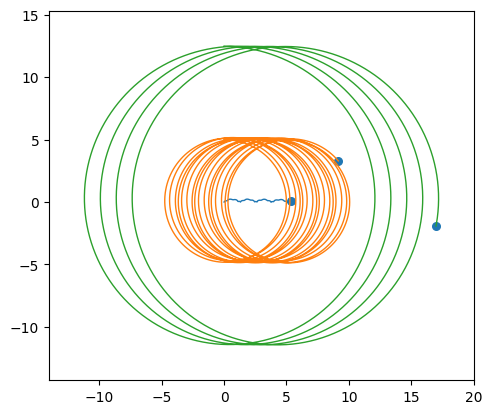

In [104]:

from matplotlib.animation import FuncAnimation
from IPython.display import HTML


x_traj = sol_num.y[0:N, :]
y_traj = sol_num.y[N:2*N, :]

fig, ax = plt.subplots()
ax.set_aspect("equal", "box")

xmin, xmax = float(x_traj.min()), float(x_traj.max())
ymin, ymax = float(y_traj.min()), float(y_traj.max())
pad = 0.1 * max(xmax - xmin, ymax - ymin, 1.0)
ax.set_xlim(xmin - pad, xmax + pad)
ax.set_ylim(ymin - pad, ymax + pad)

lines = [ax.plot([], [], lw=1)[0] for _ in range(N)]
pts = ax.scatter(x_traj[:, 0], y_traj[:, 0], s=30)

def init():
    for ln in lines:
        ln.set_data([], [])
    pts.set_offsets(np.c_[x_traj[:, 0], y_traj[:, 0]])
    return [*lines, pts]

def update(k):
    for i in range(N):
        lines[i].set_data(x_traj[i, :k+1], y_traj[i, :k+1])
    pts.set_offsets(np.c_[x_traj[:, k], y_traj[:, k]])
    return [*lines, pts]

anim = FuncAnimation(fig, update, frames=x_traj.shape[1], init_func=init, interval=20, blit=True)
HTML(anim.to_jshtml())